# パッケージインストール

In [ ]:
!pip install -U transformers flash_attn timm

# モデル準備

In [ ]:
import torch
from transformers import AutoProcessor, AutoModelForCausalLM

device = 'cuda:0'  # 'cpu'

# model_name = "microsoft/Florence-2-base"
model_name = "microsoft/Florence-2-large"
# model_name = "microsoft/Florence-2-base-ft"
# model_name = "microsoft/Florence-2-large-ft"

# モデルとプロセッサの準備
model = AutoModelForCausalLM.from_pretrained(
    model_name,
    torch_dtype=torch.float16,
    trust_remote_code=True
).to(device)
processor = AutoProcessor.from_pretrained(
    model_name,
    trust_remote_code=True
)

# 推論用関数準備

In [3]:
def run_inference(
    model,
    processor,
    input_image,
    task_prompt,
    text_input=None,
    max_new_tokens=1024,
    num_beams=3,
    do_sample=False,
    temperature=None,
    device='cpu'
):
    # 入力プロンプト準備
    if text_input is None:
        prompt = task_prompt
    else:
        prompt = task_prompt + text_input
    inputs = processor(text=prompt, images=input_image, return_tensors="pt").to(device, torch.float16)

    image_width, image_height = input_image.shape[1], input_image.shape[0]

    # 推論
    generated_ids = model.generate(
        input_ids=inputs["input_ids"],
        pixel_values=inputs["pixel_values"],
        max_new_tokens=max_new_tokens,
        num_beams=num_beams,
        do_sample=do_sample,
        temperature=temperature,
    )

    # デコード
    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=False)[0]
    result = processor.post_process_generation(
        generated_text,
        task=task_prompt,
        image_size=(image_width, image_height),
    )

    return result

# 描画用関数準備

In [4]:
import copy

import cv2
import numpy as np

def get_id_color(index):
    temp_index = abs(int(index + 5)) * 3
    color = (
        (37 * temp_index) % 255,
        (17 * temp_index) % 255,
        (29 * temp_index) % 255,
    )
    return color

def draw_bboxes(bgr_image, bboxes, labels, thickness=2):
    debug_image = copy.deepcopy(bgr_image)

    class_name_dict = {}

    for bbox, label in zip(bboxes, labels):
        # クラス名とIDを整理
        if label not in class_name_dict:
            new_id = len(class_name_dict)
            class_name_dict[label] = new_id

        # bbox
        x1, y1, x2, y2 = bbox
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
        color = get_id_color(int(class_name_dict[label]))
        cv2.rectangle(
            debug_image,
            (x1, y1),
            (x2, y2),
            color,
            thickness=thickness,
        )

        # label
        cv2.putText(
            debug_image,
            label,
            (x1, y1 - 5),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.8,
            color,
            thickness=thickness,
        )

    return debug_image, class_name_dict

def draw_quad_bboxes(bgr_image, quad_bboxes, labels, thickness=2):
    debug_image = copy.deepcopy(bgr_image)

    class_name_dict = {}

    for quad_bbox, label in zip(quad_bboxes, labels):
        # クラス名とIDを整理
        if label not in class_name_dict:
            new_id = len(class_name_dict)
            class_name_dict[label] = new_id

        # bbox
        x1, y1, x2, y2, x3, y3, x4, y4 = quad_bbox
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
        x3, y3, x4, y4 = int(x3), int(y3), int(x4), int(y4)
        color = get_id_color(int(class_name_dict[label]))

        cv2.line(debug_image, (x1, y1), (x2, y2), color=color, thickness=thickness)
        cv2.line(debug_image, (x2, y2), (x3, y3), color=color, thickness=thickness)
        cv2.line(debug_image, (x3, y3), (x4, y4), color=color, thickness=thickness)
        cv2.line(debug_image, (x4, y4), (x1, y1), color=color, thickness=thickness)

        # label
        cv2.putText(
            debug_image,
            label,
            (x1, y1 - 5),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.8,
            color,
            thickness=thickness,
        )

    return debug_image, class_name_dict

def draw_segmentation(bgr_image, polygons, labels, thickness=2, fill_poly=True):
    debug_image = copy.deepcopy(bgr_image)

    class_name_dict = {}

    for polygon, label in zip(polygons, labels):
        # クラス名とIDを整理
        if label not in class_name_dict:
            new_id = len(class_name_dict)
            class_name_dict[label] = new_id

        # polygon
        for polygon in polygons:
            polygon = np.array(polygon).reshape(-1, 2)
            if len(polygon) < 3:
                continue

            polygon = polygon.astype(int)
            polygon = polygon.reshape((-1, 1, 2))

            color = get_id_color(int(class_name_dict[label]))
            cv2.polylines(
                debug_image,
                [polygon],
                isClosed=True,
                color=color,
                thickness=thickness,
            )
            if fill_poly:
                cv2.fillPoly(
                    debug_image,
                    [polygon],
                    color=color,
                )

    return debug_image, class_name_dict

# サンプル画像準備

In [5]:
!wget https://raw.githubusercontent.com/Kazuhito00/Florence-2-Colaboratory-Sample/main/sample.jpg -O sample.jpg

--2024-08-17 14:32:43--  https://raw.githubusercontent.com/Kazuhito00/Florence-2-Colaboratory-Sample/main/sample.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 300719 (294K) [image/jpeg]
Saving to: ‘sample.jpg’

sample.jpg          100%[===================>] 293.67K  --.-KB/s    in 0.02s   

2024-08-17 14:32:43 (11.9 MB/s) - ‘sample.jpg’ saved [300719/300719]



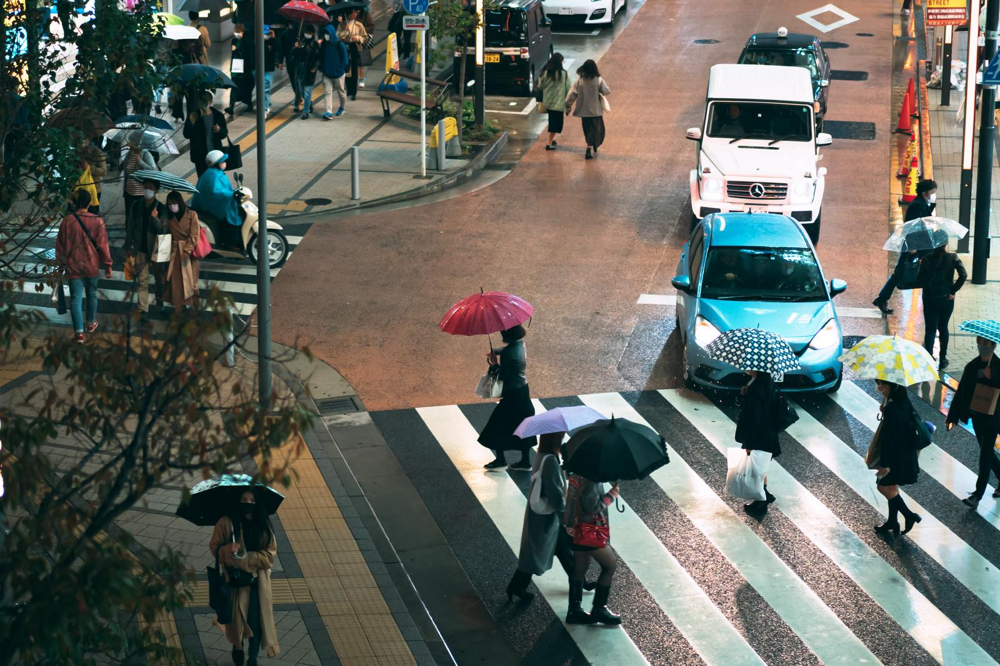

In [6]:
import cv2
from google.colab.patches import cv2_imshow

bgr_image = cv2.imread('sample.jpg')
rgb_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)
cv2_imshow(bgr_image)

# プロンプト：キャプション

In [31]:
%%time

# キャプション
prompt = "<CAPTION>"
result = run_inference(model, processor, rgb_image, prompt, device=device)
print(result)

{'<CAPTION>': 'A group of people crossing a street with umbrellas.'}
CPU times: user 444 ms, sys: 3.93 ms, total: 448 ms
Wall time: 448 ms


In [32]:
%%time

# 詳細なキャプション
prompt = "<DETAILED_CAPTION>"
result = run_inference(model, processor, rgb_image, prompt, device=device)
print(result)

{'<DETAILED_CAPTION>': 'The image shows a group of people walking across a crosswalk with umbrellas, surrounded by vehicles on the road, poles, boards, traffic cones, plants, trees, and buildings in the background.'}
CPU times: user 1.16 s, sys: 7.59 ms, total: 1.17 s
Wall time: 1.24 s


In [33]:
%%time

# より詳細なキャプション
prompt = "<MORE_DETAILED_CAPTION>"
result = run_inference(model, processor, rgb_image, prompt, device=device)
print(result)

{'<MORE_DETAILED_CAPTION>': 'The image shows a busy street scene in a city. There are multiple vehicles on the road, including a blue car and a white van. The street is lined with trees and buildings, and there are people walking on the sidewalk, some of them holding umbrellas to protect themselves from the rain. The sky is overcast and the overall mood of the image is gloomy.'}
CPU times: user 1.4 s, sys: 2.53 ms, total: 1.41 s
Wall time: 1.48 s


# プロンプト：物体検出

In [34]:
%%time

# 物体検出
prompt = "<OD>"
result = run_inference(model, processor, rgb_image, prompt, device=device)
print(result)

{'<OD>': {'bboxes': [[1069.5999755859375, 334.1910095214844, 1364.0, 632.6710205078125], [1093.5999755859375, 100.73699951171875, 1336.800048828125, 364.03900146484375], [1176.800048828125, 43.17300033569336, 1332.0, 182.81900024414062], [941.6000366210938, 935.4149780273438, 999.2000122070312, 1002.572998046875], [807.2000122070312, 914.094970703125, 858.4000244140625, 964.1969604492188], [943.2000122070312, 969.5269775390625, 999.2000122070312, 1002.572998046875], [1188.0, 790.43896484375, 1242.4000244140625, 822.4190063476562], [1437.5999755859375, 820.2869873046875, 1477.5999755859375, 856.531005859375], [903.2000122070312, 974.8569946289062, 952.7999877929688, 1000.4409790039062], [1392.800048828125, 477.0350036621094, 1432.800048828125, 502.6189880371094], [1394.4000244140625, 834.1449584960938, 1439.2000732421875, 855.4649658203125], [770.4000244140625, 733.9409790039062, 813.6000366210938, 752.06298828125], [810.4000244140625, 738.2050170898438, 855.2000122070312, 755.260986328

{'car': 0, 'footwear': 1, 'land vehicle': 2, 'person': 3, 'wheel': 4, 'woman': 5}


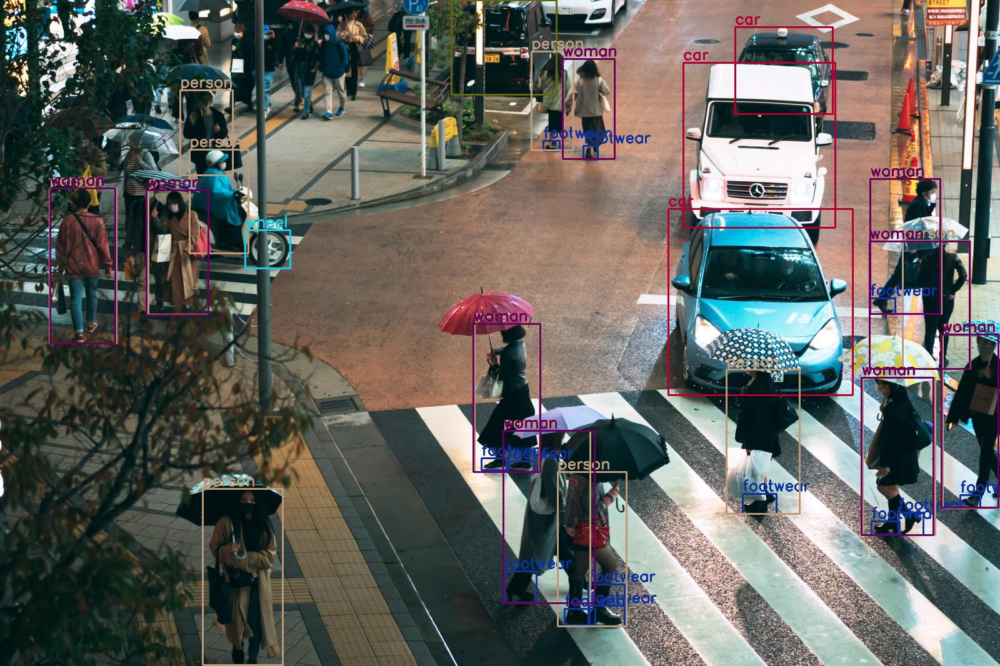

In [35]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<OD>']['bboxes'],
    result['<OD>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [36]:
%%time

# 高密度領域キャプション
prompt = "<DENSE_REGION_CAPTION>"
result = run_inference(model, processor, rgb_image, prompt, device=device)
print(result)

{'<DENSE_REGION_CAPTION>': {'bboxes': [[1071.2000732421875, 334.1910095214844, 1364.0, 632.6710205078125], [1093.5999755859375, 100.73699951171875, 1338.4000244140625, 365.10498046875], [805.6000366210938, 689.1690063476562, 951.2000122070312, 966.3289794921875], [325.6000061035156, 782.9769897460938, 453.6000061035156, 1064.4010009765625], [893.6000366210938, 755.260986328125, 1004.0, 1002.572998046875], [1381.5999755859375, 604.9550170898438, 1498.4000244140625, 856.531005859375], [1394.4000244140625, 286.22100830078125, 1509.5999755859375, 502.6189880371094], [1165.5999755859375, 590.031005859375, 1280.800048828125, 822.4190063476562], [1445.5999755859375, 367.23699951171875, 1556.0, 590.031005859375], [760.7999877929688, 518.6090087890625, 866.4000244140625, 755.260986328125], [82.4000015258789, 302.21099853515625, 188.0, 549.5230102539062], [1509.5999755859375, 535.6649780273438, 1597.5999755859375, 812.8250122070312], [895.2000122070312, 662.5189819335938, 1077.5999755859375, 776

{'blue car with polka dot umbrella on city street': 0, 'Mercedes-Benz Sprinter van on street': 1, 'woman with red purse and black umbrella on rainy day': 2, 'woman with black umbrella and fur coat on street': 3, 'woman with pink umbrella on street with shopping bags and red purse': 4, 'woman with umbrella on zebra crossing': 5, 'woman with blue and white polka-dot umbrella on busy street': 6, 'woman with shopping bag on zigzag patterned street': 7, 'woman with yellow and black polka dots umbrella on sidewalk': 8, 'woman with colorful umbrella on snowy street': 9, 'woman with brown coat and red scarf walking on street': 10, 'woman with suitcase on zipline with umbrella': 11, "black umbrella on person's shoulder": 12, 'woman with green and white patterned umbrella on bus': 13, 'woman with orange coat and pink purse on street': 14, 'person with red umbrella on red carpet': 15, 'person with blue umbrella on subway platform': 16, 'person with yellow polka dotted umbrella on bicycle': 17, 'p

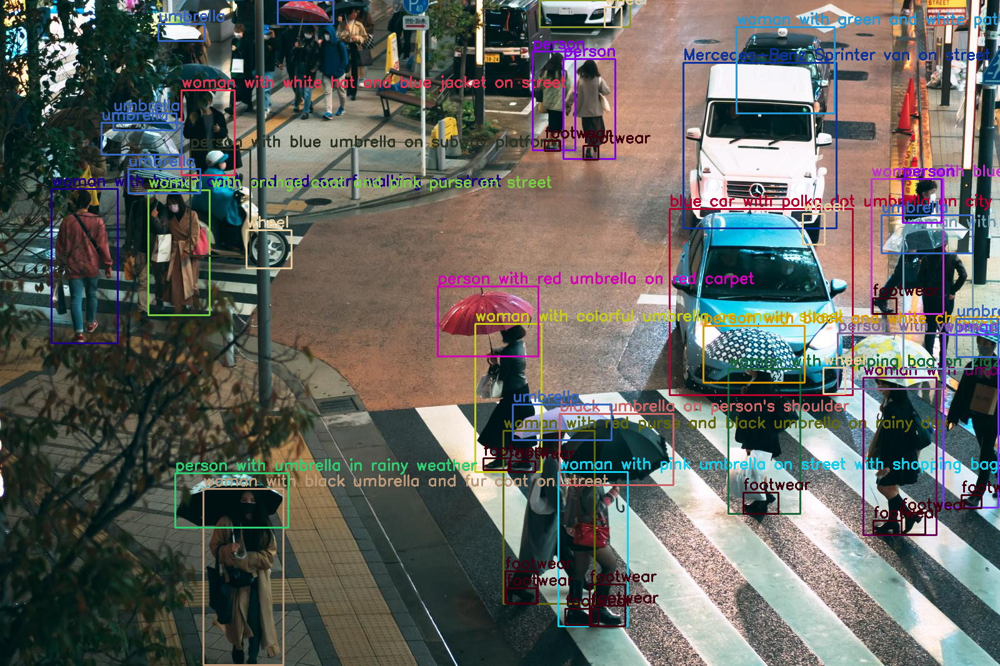

In [37]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<DENSE_REGION_CAPTION>']['bboxes'],
    result['<DENSE_REGION_CAPTION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [38]:
%%time

# 領域提案
prompt = "<REGION_PROPOSAL>"
result = run_inference(model, processor, rgb_image, prompt, device=device)
print(result)

{'<REGION_PROPOSAL>': {'bboxes': [[0.800000011920929, 0.5329999923706055, 1597.5999755859375, 1064.4010009765625], [0.800000011920929, 0.5329999923706055, 604.0, 550.5889892578125], [0.800000011920929, 0.5329999923706055, 602.4000244140625, 207.3369903564453], [1069.5999755859375, 334.1910095214844, 1364.0, 633.7369995117188], [1093.5999755859375, 100.73699951171875, 1336.800048828125, 366.1709899902344], [0.800000011920929, 0.5329999923706055, 599.2000122070312, 107.13299560546875], [0.800000011920929, 0.5329999923706055, 597.6000366210938, 69.822998046875], [805.6000366210938, 690.2349853515625, 951.2000122070312, 967.3949584960938], [999.2000122070312, 1001.5069580078125, 903.2000122070312, 974.8569946289062], [956.0, 1000.4409790039062, 1440.800048828125, 820.2869873046875], [1477.5999755859375, 855.4649658203125, 1392.800048828125, 477.0350036621094], [1432.800048828125, 502.6189880371094, 1396.0, 833.0789794921875], [1439.2000732421875, 854.3989868164062, 367.20001220703125, 1037

{'': 0}


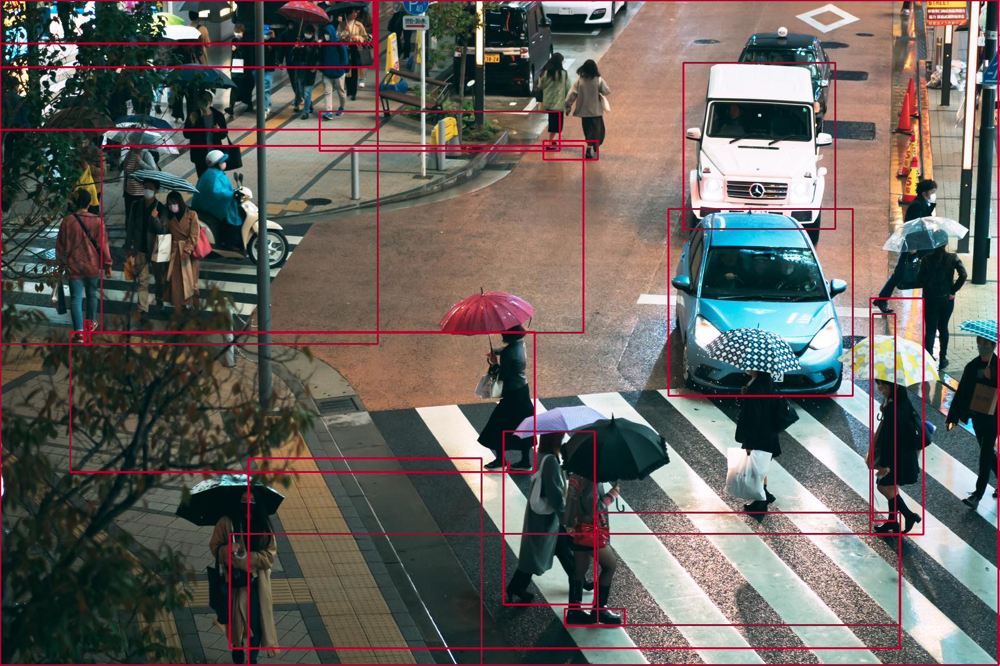

In [39]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<REGION_PROPOSAL>']['bboxes'],
    result['<REGION_PROPOSAL>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [40]:
%%time

# キャプションからフレーズへの接地
prompt = "<CAPTION_TO_PHRASE_GROUNDING>"
text_input = 'woman'
result = run_inference(model, processor, rgb_image, prompt, text_input, device=device)
print(result)

{'<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[330.3999938964844, 781.9110107421875, 450.3999938964844, 1064.4010009765625], [807.2000122070312, 689.1690063476562, 917.6000366210938, 968.4609985351562], [896.7999877929688, 750.9970092773438, 999.2000122070312, 1004.7049560546875], [1381.5999755859375, 603.8889770507812, 1484.0, 860.7949829101562], [85.5999984741211, 300.0790100097656, 183.1999969482422, 552.7210083007812], [762.4000244140625, 518.6090087890625, 860.0, 758.458984375], [1170.4000244140625, 590.031005859375, 1258.4000244140625, 825.6170043945312], [250.40000915527344, 304.3429870605469, 325.6000061035156, 510.08099365234375], [903.2000122070312, 94.34099578857422, 980.0, 257.4389953613281], [853.6000366210938, 83.68099975585938, 914.4000244140625, 243.58099365234375]], 'labels': ['woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman']}}
CPU times: user 771 ms, sys: 2.9 ms, total: 774 ms
Wall time: 796 ms


{'woman': 0}


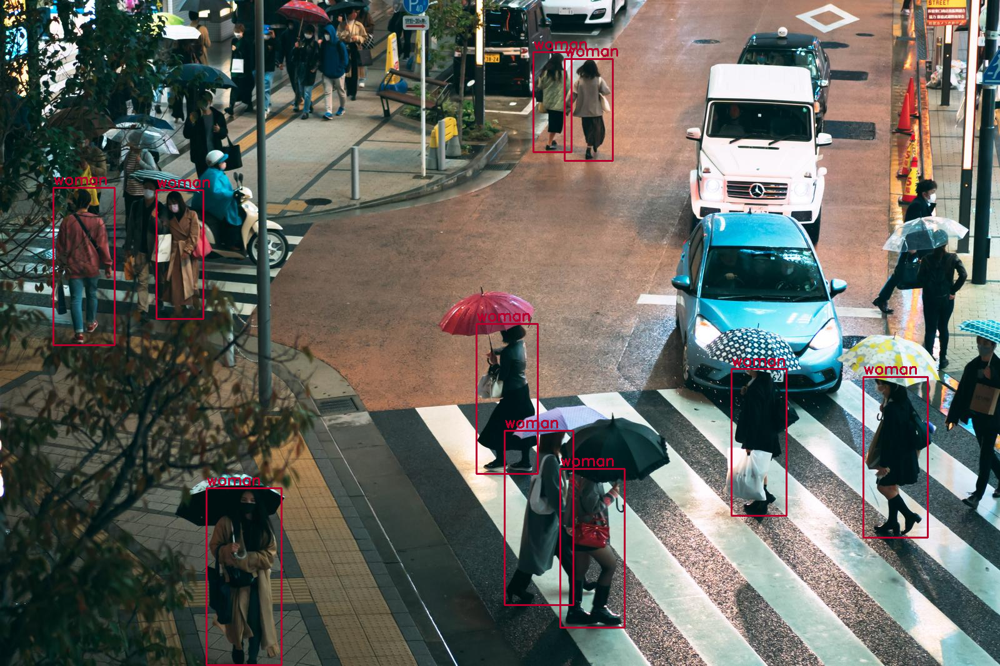

In [41]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<CAPTION_TO_PHRASE_GROUNDING>']['bboxes'],
    result['<CAPTION_TO_PHRASE_GROUNDING>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [42]:
%%time

# オープンボキャブラリー物体検出
prompt = "<OPEN_VOCABULARY_DETECTION>"
text_input = 'woman'
result = run_inference(model, processor, rgb_image, prompt, text_input, device=device)
print(result)

{'<OPEN_VOCABULARY_DETECTION>': {'bboxes': [[805.6000366210938, 689.1690063476562, 951.2000122070312, 966.3289794921875], [325.6000061035156, 782.9769897460938, 453.6000061035156, 1064.4010009765625], [1380.0, 604.9550170898438, 1496.800048828125, 856.531005859375], [892.0, 755.260986328125, 1004.0, 1002.572998046875], [1165.5999755859375, 591.0969848632812, 1279.2000732421875, 821.3529663085938], [759.2000122070312, 518.6090087890625, 864.7999877929688, 755.260986328125], [232.8000030517578, 304.3429870605469, 332.0, 504.7510070800781], [900.0, 94.34099578857422, 983.2000122070312, 254.24099731445312], [850.4000244140625, 82.61499786376953, 919.2000122070312, 240.38299560546875]], 'bboxes_labels': ['woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman'], 'polygons': [], 'polygons_labels': []}}
CPU times: user 718 ms, sys: 2.95 ms, total: 721 ms
Wall time: 749 ms


{'woman': 0}
{}


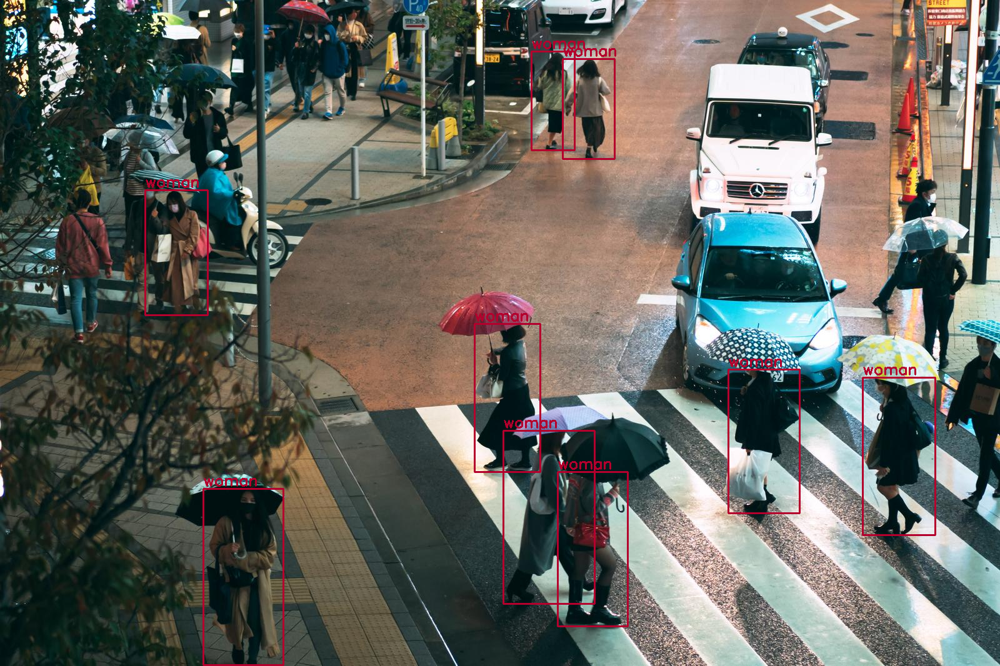

In [43]:
debug_image, bboxes_class_name_dict = draw_bboxes(
    bgr_image,
    result['<OPEN_VOCABULARY_DETECTION>']['bboxes'],
    result['<OPEN_VOCABULARY_DETECTION>']['bboxes_labels'],
)
debug_image, polygons_class_name_dict = draw_segmentation(
    debug_image,
    result['<OPEN_VOCABULARY_DETECTION>']['polygons'],
    result['<OPEN_VOCABULARY_DETECTION>']['polygons_labels'],
)

print(bboxes_class_name_dict)
print(polygons_class_name_dict)
cv2_imshow(debug_image)

# プロンプト：セグメンテーション

In [44]:
%%time

# 参照セグメンテーション
prompt = "<REFERRING_EXPRESSION_SEGMENTATION>"
text_input = 'road'
result = run_inference(model, processor, rgb_image, prompt, text_input, device=device)
print(result)

{'<REFERRING_EXPRESSION_SEGMENTATION>': {'polygons': [[[504.8000183105469, 359.7749938964844, 516.0, 356.5769958496094, 532.0, 354.44500732421875, 541.6000366210938, 351.24700927734375, 557.6000366210938, 349.114990234375, 567.2000122070312, 346.9830017089844, 583.2000122070312, 344.8509826660156, 592.7999877929688, 342.718994140625, 608.7999877929688, 340.5870056152344, 618.4000244140625, 338.4549865722656, 634.4000244140625, 336.322998046875, 644.0, 334.1910095214844, 658.4000244140625, 332.0589904785156, 668.0, 329.927001953125, 680.7999877929688, 327.79498291015625, 688.7999877929688, 325.6629943847656, 701.6000366210938, 323.531005859375, 712.7999877929688, 320.3330078125, 722.4000244140625, 318.20098876953125, 732.0, 315.00299072265625, 740.0, 311.80499267578125, 749.6000366210938, 309.6730041503906, 757.6000366210938, 306.4750061035156, 765.6000366210938, 303.2770080566406, 773.6000366210938, 301.1449890136719, 781.6000366210938, 297.9469909667969, 789.6000366210938, 294.7489929

{'': 0}


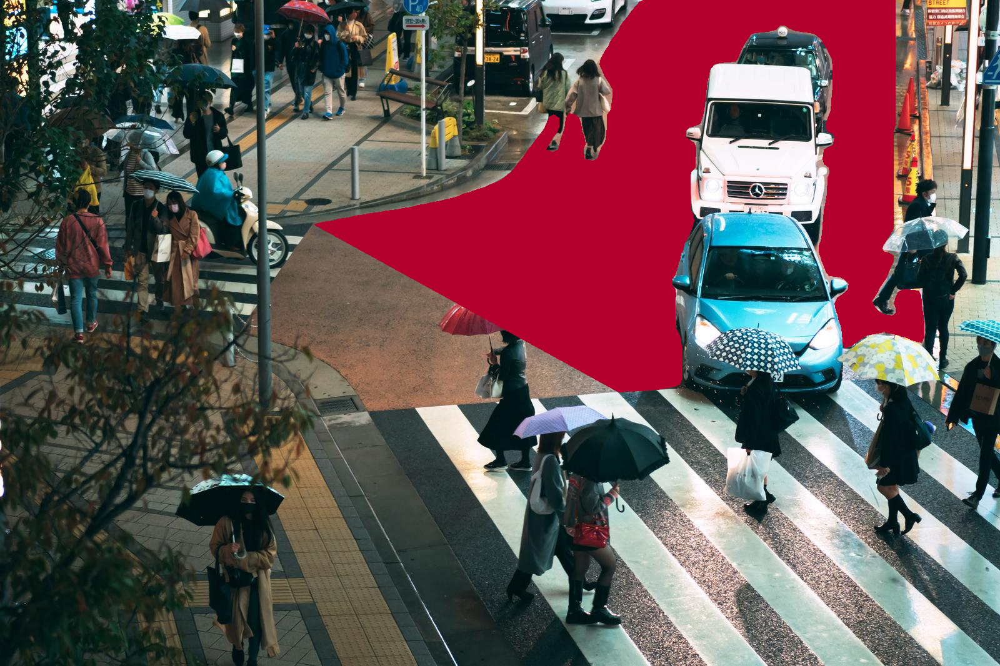

In [45]:
debug_image, class_name_dict = draw_segmentation(
    bgr_image,
    result['<REFERRING_EXPRESSION_SEGMENTATION>']['polygons'],
    result['<REFERRING_EXPRESSION_SEGMENTATION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [46]:
%%time

image_width, image_height = rgb_image.shape[1], rgb_image.shape[0]
target_x1, target_y1, target_x2, target_y2 = 1069, 335, 1362, 633
q_target_x1 = int(target_x1 / image_width * 999)
q_target_y1 = int(target_y1 / image_height * 999)
q_target_x2 = int(target_x2 / image_width * 999)
q_target_y2 = int(target_y2 / image_height * 999)

# 領域指定セグメンテーション
prompt = "<REGION_TO_SEGMENTATION>"
# フォーマット：'<loc_x1><loc_y1><loc_x2><loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].
text_input = '<loc_' + str(q_target_x1) + '><loc_' + str(q_target_y1) + '><loc_' + str(q_target_x2) + '><loc_' + str(q_target_y2) + '>'
print(text_input)
result = run_inference(model, processor, rgb_image, prompt, text_input, device=device)
print(result)

<loc_667><loc_313><loc_850><loc_593>
{'<REGION_TO_SEGMENTATION>': {'polygons': [[[1122.4000244140625, 354.44500732421875, 1128.800048828125, 349.114990234375, 1132.0, 346.9830017089844, 1133.5999755859375, 345.9169921875, 1136.800048828125, 344.8509826660156, 1140.0, 343.7850036621094, 1143.2000732421875, 342.718994140625, 1148.0, 341.6529846191406, 1154.4000244140625, 340.5870056152344, 1162.4000244140625, 339.52099609375, 1168.800048828125, 339.52099609375, 1170.4000244140625, 340.5870056152344, 1189.5999755859375, 341.6529846191406, 1192.800048828125, 341.6529846191406, 1194.4000244140625, 340.5870056152344, 1197.5999755859375, 339.52099609375, 1200.800048828125, 339.52099609375, 1202.4000244140625, 340.5870056152344, 1205.5999755859375, 341.6529846191406, 1208.800048828125, 341.6529846191406, 1210.4000244140625, 340.5870056152344, 1213.5999755859375, 339.52099609375, 1216.800048828125, 339.52099609375, 1218.4000244140625, 340.5870056152344, 1221.5999755859375, 341.6529846191406, 12

{'': 0}


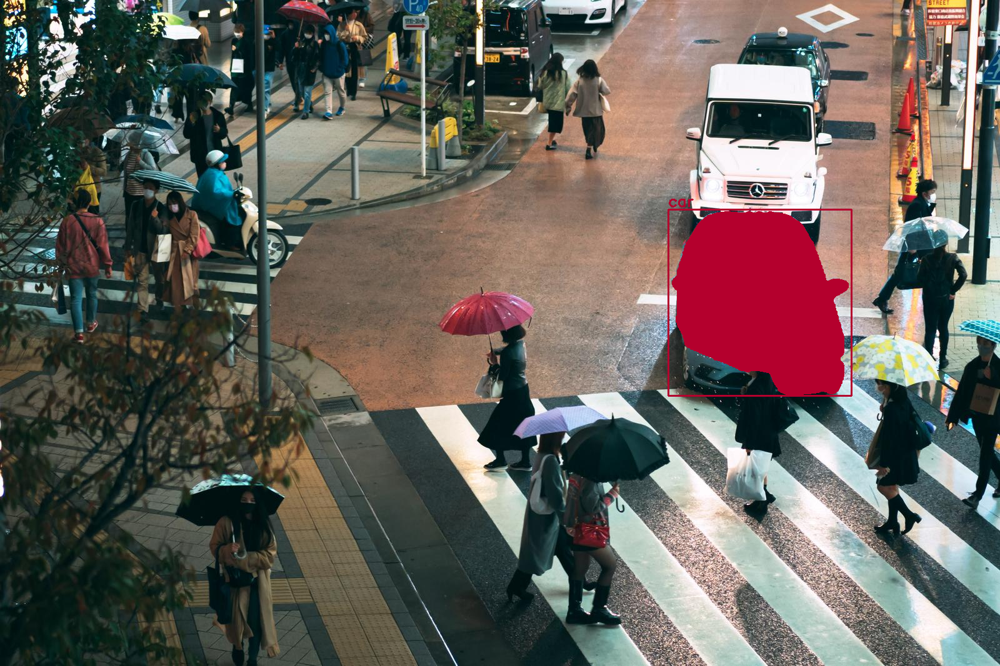

In [47]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    [[target_x1, target_y1, target_x2, target_y2]],
    ['car'],
)
debug_image, class_name_dict = draw_segmentation(
    debug_image,
    result['<REGION_TO_SEGMENTATION>']['polygons'],
    result['<REGION_TO_SEGMENTATION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

# 領域→テキスト

In [48]:
%%time

image_width, image_height = rgb_image.shape[1], rgb_image.shape[0]
target_x1, target_y1, target_x2, target_y2 = 1069, 335, 1362, 633
q_target_x1 = int(target_x1 / image_width * 999)
q_target_y1 = int(target_y1 / image_height * 999)
q_target_x2 = int(target_x2 / image_width * 999)
q_target_y2 = int(target_y2 / image_height * 999)

# 領域→カテゴリー
prompt = "<REGION_TO_CATEGORY>"
# フォーマット：'<loc_x1><loc_y1><loc_x2><loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].
text_input = '<loc_' + str(q_target_x1) + '><loc_' + str(q_target_y1) + '><loc_' + str(q_target_x2) + '><loc_' + str(q_target_y2) + '>'
print(text_input)
result = run_inference(model, processor, rgb_image, prompt, text_input, device=device)
print(result)

<loc_667><loc_313><loc_850><loc_593>
{'<REGION_TO_CATEGORY>': 'car<loc_667><loc_313><loc_850><loc_593>'}
CPU times: user 315 ms, sys: 794 µs, total: 316 ms
Wall time: 329 ms


In [49]:
%%time

image_width, image_height = rgb_image.shape[1], rgb_image.shape[0]
target_x1, target_y1, target_x2, target_y2 = 1069, 335, 1362, 633
q_target_x1 = int(target_x1 / image_width * 999)
q_target_y1 = int(target_y1 / image_height * 999)
q_target_x2 = int(target_x2 / image_width * 999)
q_target_y2 = int(target_y2 / image_height * 999)

# 領域→説明
prompt = "<REGION_TO_DESCRIPTION>"
# フォーマット：'<loc_x1><loc_y1><loc_x2><loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].
text_input = '<loc_' + str(q_target_x1) + '><loc_' + str(q_target_y1) + '><loc_' + str(q_target_x2) + '><loc_' + str(q_target_y2) + '>'
print(text_input)
result = run_inference(model, processor, rgb_image, prompt, text_input, device=device)
print(result)

<loc_667><loc_313><loc_850><loc_593>
{'<REGION_TO_DESCRIPTION>': 'blue car with polka dot umbrella on street<loc_667><loc_313><loc_850><loc_593>'}
CPU times: user 458 ms, sys: 6.99 ms, total: 465 ms
Wall time: 484 ms


# OCR

In [50]:
!wget !wget https://raw.githubusercontent.com/Kazuhito00/Florence-2-Colaboratory-Sample/main/sample2.jpg -O sample2.jpg

--2024-08-17 14:34:24--  http://!wget/
Resolving !wget (!wget)... failed: Name or service not known.
wget: unable to resolve host address ‘!wget’
--2024-08-17 14:34:24--  https://raw.githubusercontent.com/Kazuhito00/Florence-2-Colaboratory-Sample/main/sample2.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 268078 (262K) [image/jpeg]
Saving to: ‘sample2.jpg’

sample2.jpg         100%[===================>] 261.79K  --.-KB/s    in 0.03s   

2024-08-17 14:34:24 (7.70 MB/s) - ‘sample2.jpg’ saved [268078/268078]

FINISHED --2024-08-17 14:34:24--
Total wall clock time: 0.08s
Downloaded: 1 files, 262K in 0.03s (7.70 MB/s)


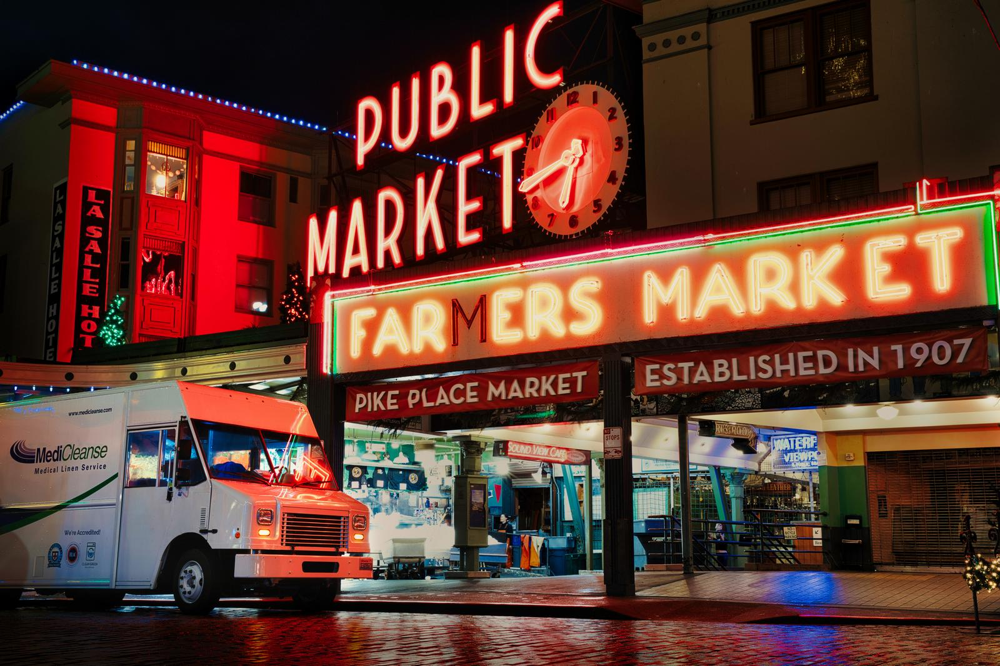

In [51]:
import cv2
from google.colab.patches import cv2_imshow

bgr_image2 = cv2.imread('sample2.jpg')
rgb_image2 = cv2.cvtColor(bgr_image2, cv2.COLOR_BGR2RGB)
cv2_imshow(bgr_image2)

In [52]:
%%time

# OCR
prompt = '<OCR>'
result = run_inference(model, processor, rgb_image2, prompt, device=device)
print(result)

{'<OCR>': 'PUBLICMARKETFARMERS MARKETPIKE PLACE MARKETESTABLISHED IN 1907www.medicleanse.comMediCleanseSOUND NEW CARSWATERPMedical Linen ServiceMEMPHEWire-licensed'}
CPU times: user 934 ms, sys: 3.85 ms, total: 937 ms
Wall time: 990 ms


In [53]:
%%time

# OCR（領域）
prompt = '<OCR_WITH_REGION>'
result = run_inference(model, processor, rgb_image2, prompt, device=device)
print(result)

{'<OCR_WITH_REGION>': {'quad_boxes': [[520.7999877929688, 159.36700439453125, 895.2000122070312, 0.5329999923706055, 941.6000366210938, 129.5189971923828, 568.7999877929688, 279.8249816894531], [898.4000244140625, 149.7729949951172, 927.2000122070312, 143.3769989013672, 930.4000244140625, 164.69699096679688, 901.6000366210938, 171.09300231933594], [970.4000244140625, 172.15899658203125, 988.0, 171.09300231933594, 989.6000366210938, 192.41299438476562, 972.0, 193.47900390625], [976.7999877929688, 219.06300354003906, 996.0, 217.9969940185547, 997.6000366210938, 240.38299560546875, 978.4000244140625, 241.44898986816406], [464.8000183105469, 332.0589904785156, 911.2000122070312, 204.1389923095703, 948.0, 333.125, 504.8000183105469, 461.04498291015625], [548.0, 490.89300537109375, 1540.0, 360.84100341796875, 1551.2000732421875, 465.3089904785156, 559.2000122070312, 580.43701171875], [564.0, 625.208984375, 940.0, 591.0969848632812, 943.2000122070312, 632.6710205078125, 567.2000122070312, 664

{'</s>PUBLIC': 0, 'R1': 1, '2': 2, '3': 3, 'MARKETO': 4, 'FARMERS MARKET': 5, 'PIKE PLACE MARKET': 6, 'ESTABLISHED IN 1907': 7, 'www.medicleanse.com': 8, 'MediCleanse': 9, 'SOUND VIEW CARS': 10, 'MEDICAL Lien Service': 11, 'WATERF': 12, 'MEDICAL': 13, "We're icceeded": 14}


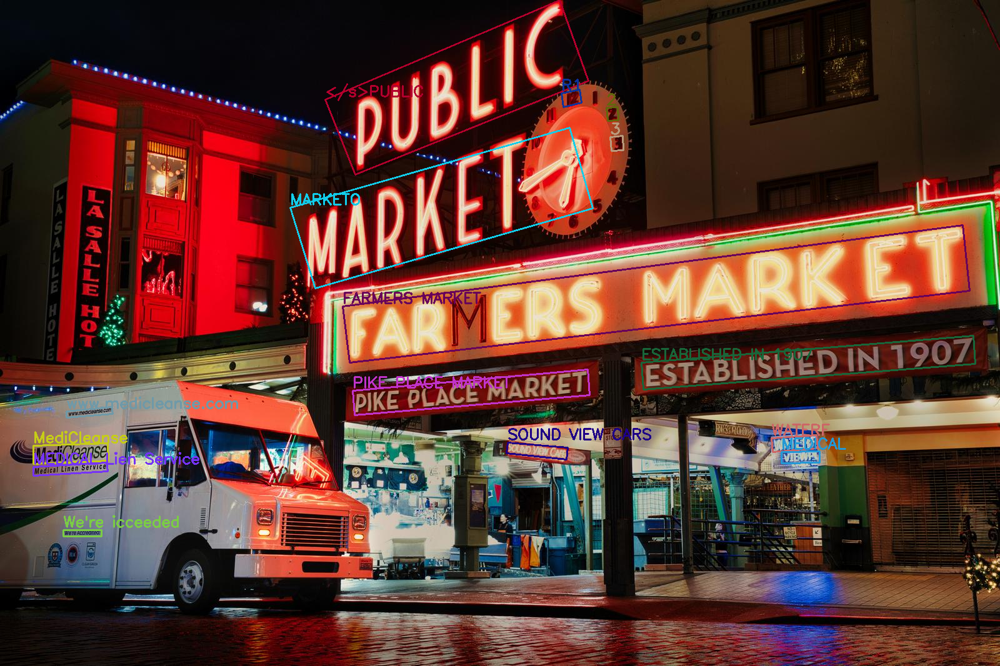

In [54]:
debug_image, class_name_dict = draw_quad_bboxes(
    bgr_image2,
    result['<OCR_WITH_REGION>']['quad_boxes'],
    result['<OCR_WITH_REGION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)